In [2]:
import os
# Set CUDA device id
#os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID" # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [3]:
# Copyright 2022 The Nerfstudio Team. All rights reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

import sys, argparse
from dataclasses import dataclass
from typing import Union

import torch
from rich.console import Console
from torch import Tensor, nn
from jaxtyping import Float

from __future__ import annotations
from typing import Any

from torch.autograd import Variable
import torchvision.transforms.functional as F
import numpy as np

from diffusers import DDIMScheduler

from PIL import Image
import copy, imageio
from tqdm import tqdm_notebook as tqdm
import logging

import sn2n.mv_img2img as mv_img2img

CONSOLE = Console(width=120)
DDIM_SOURCE = "CompVis/stable-diffusion-v1-4"

In [4]:
# set original dataset path...
source_path = '../instruct-nerf2nerf/dataset/bear' # path to original multi-view dataset
upscale_image = False # upscale recommended for instruct-nerf2nerf scenes except bear

In [5]:
# load module
from importlib import reload
import sys
reload(sys.modules['sn2n.mv_img2img'])

import sn2n.mv_img2img as mv_img2img

In [5]:
# Fully shared attention w/ sdxl
device = 'cuda'

sp2p = mv_img2img.StylePix2Pix(device, sp2p_use_full_precision=False,
                share_group_norm=True, # False
                share_layer_norm=True, # False
                share_attention=True,
                adain_queries=True,
                adain_keys=True,
                adain_values=True, # False
                full_attention_share=True # Fals:                   
                )

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

sa_args StyleAlignedArgs(share_group_norm=True, share_layer_norm=True, share_attention=True, adain_queries=True, adain_keys=True, adain_values=True, full_attention_share=True, shared_score_scale=1.0, shared_score_shift=0.0, only_self_level=0.0)


StylePix2Pix loaded!

Num of training views: 96 / file extension: jpg  at path: ../instruct-nerf2nerf/dataset/bear / Upscale training images?: False


,,

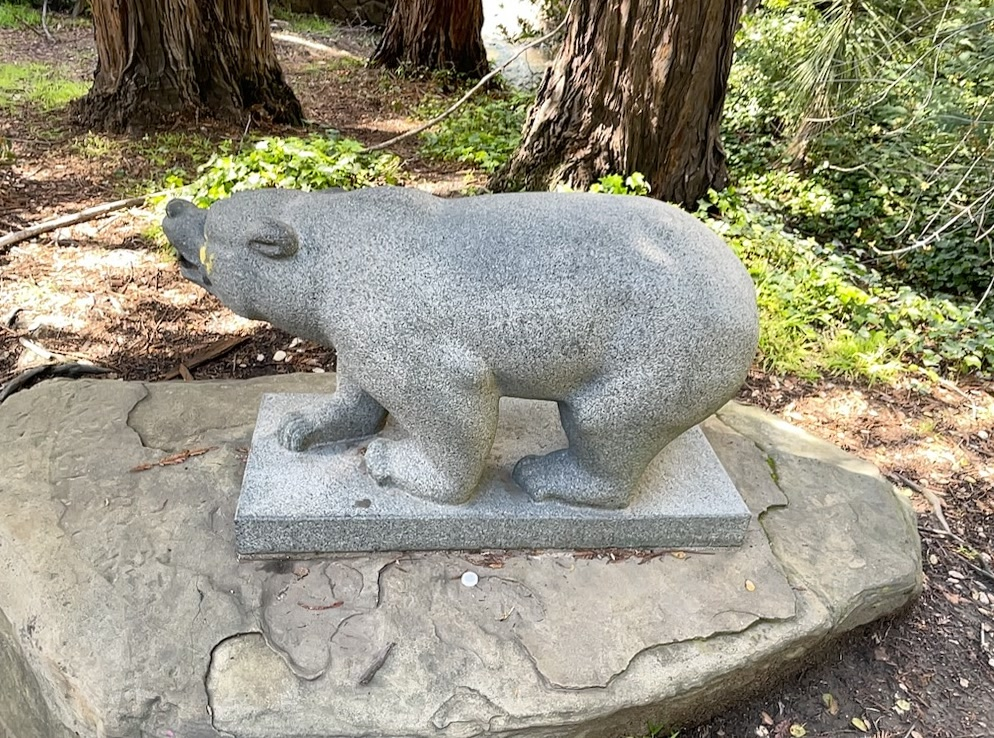
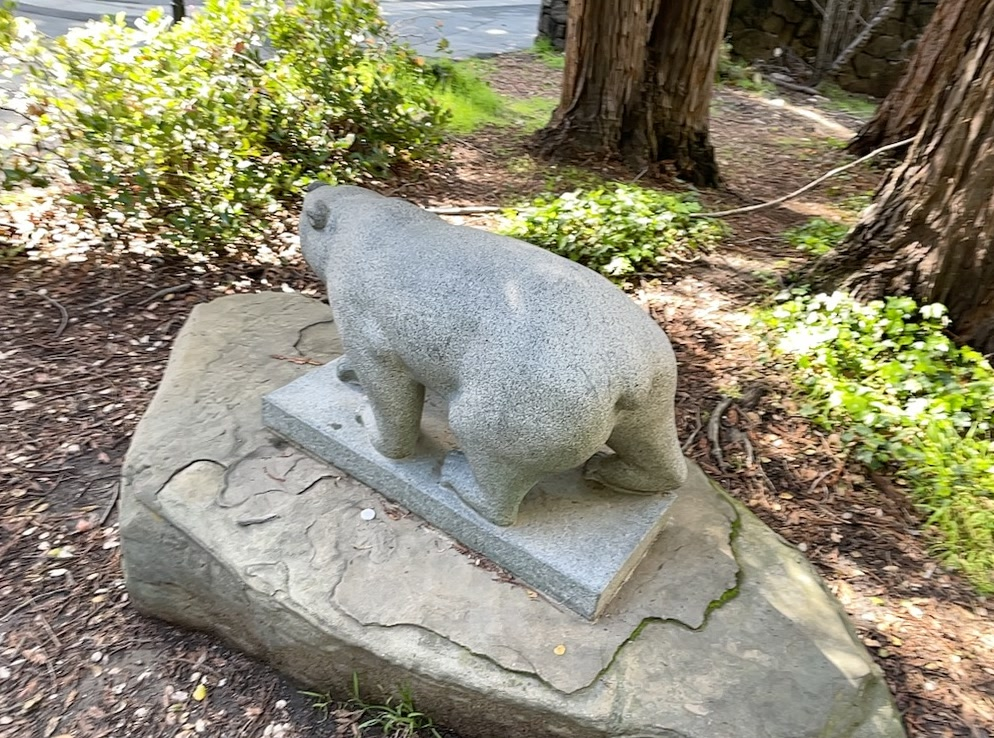
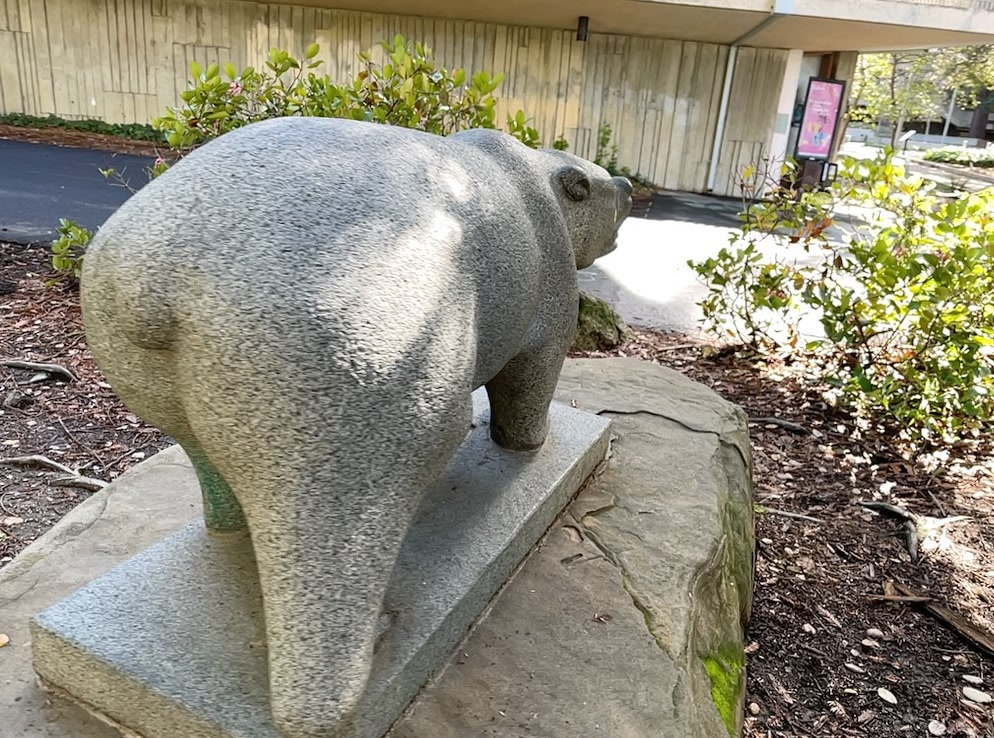

Size: (994, 738)


In [6]:
# Load source views

from diffusers.utils import load_image
import random, glob
import mediapy

g = glob.glob(f'{source_path}/images_4/*')
num_of_views =len(g)
ext = g[0].split('/')[-1].split('.')[-1]
print('Num of training views:', num_of_views, '/ file extension:', ext, ' at path:', source_path, '/ Upscale training images?:', upscale_image)

img_indices = [i for i in range(1, num_of_views+1)]

images = [load_image(f"{source_path}/images/frame_{str(i).zfill(5)}.{ext}") for i in img_indices]

H = images[0].size[1]
W = images[0].size[0]
if upscale_image:
    images = [image.resize((2*W, 2*H)) for image in images]
    #depth_images_nerf = [image.resize((2*W, 2*H)) for image in depth_images_nerf]

mediapy.show_images(images[::36])
#mediapy.show_images(depth_images_nerf[::36])

print('Size:', images[0].size)
#print(depth_images_nerf[0].size)

Size: 738 994


,,,

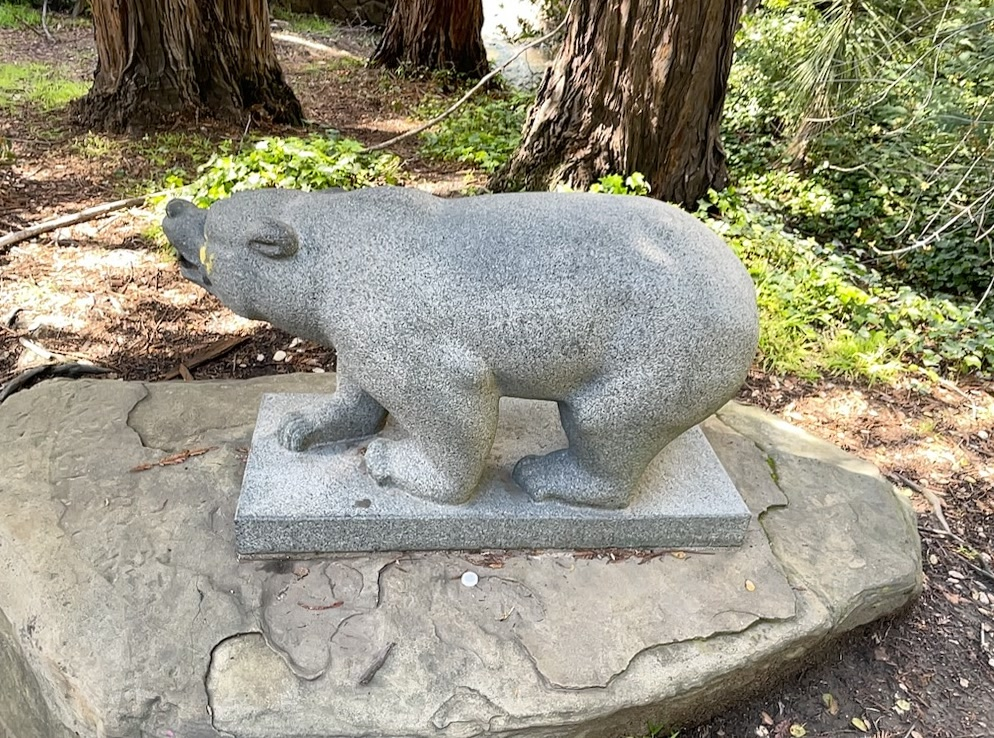
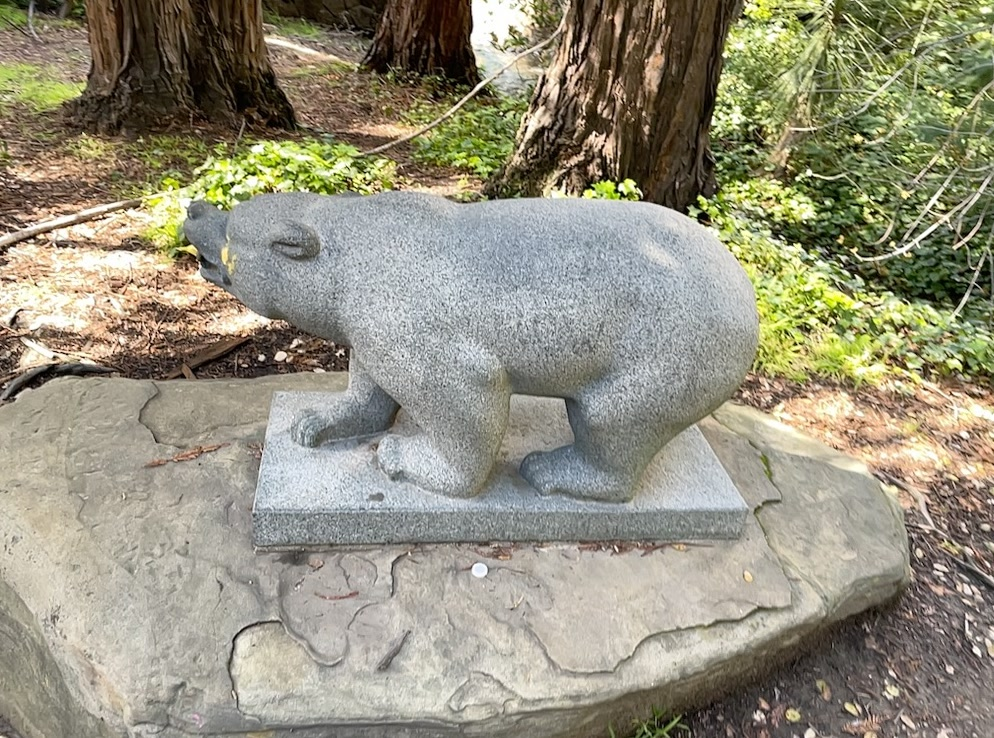
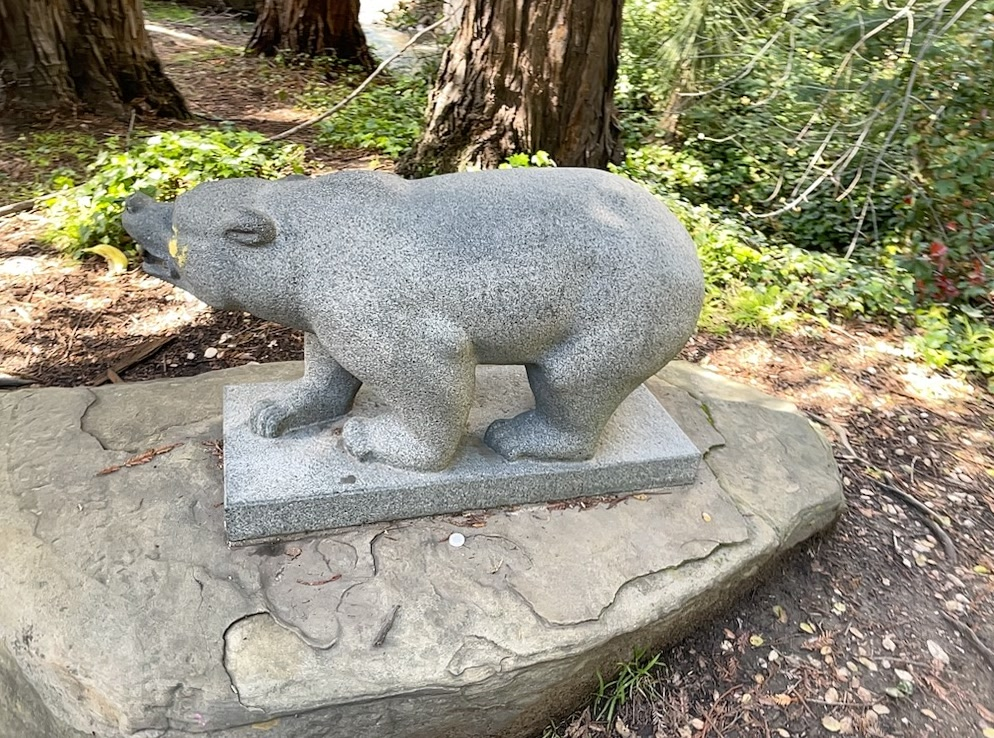
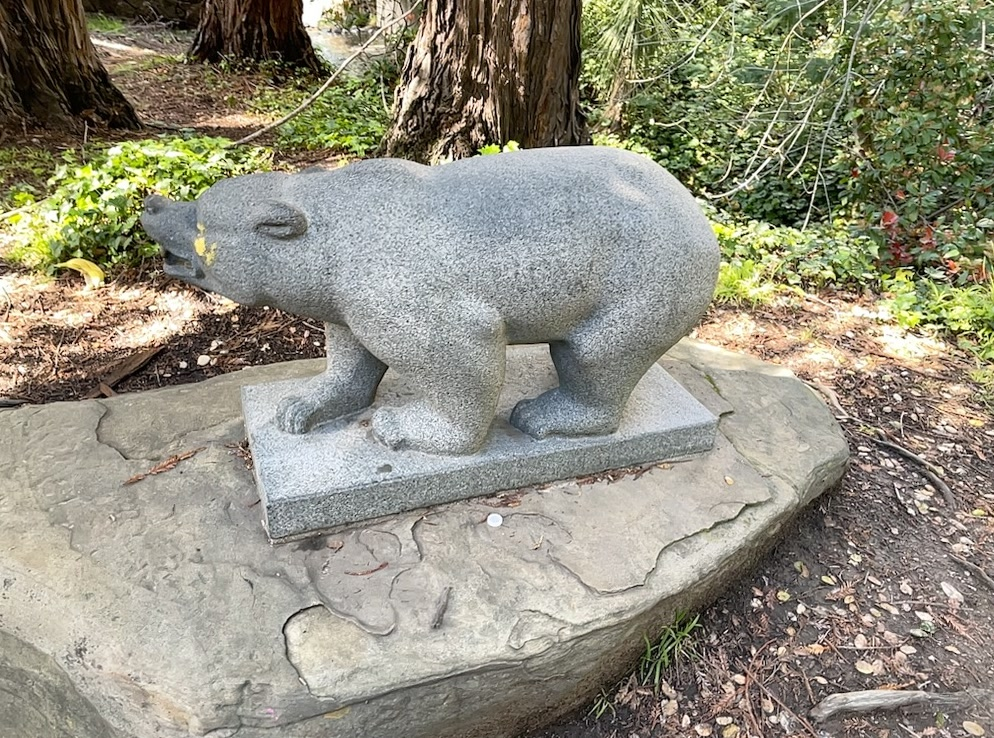

,,,

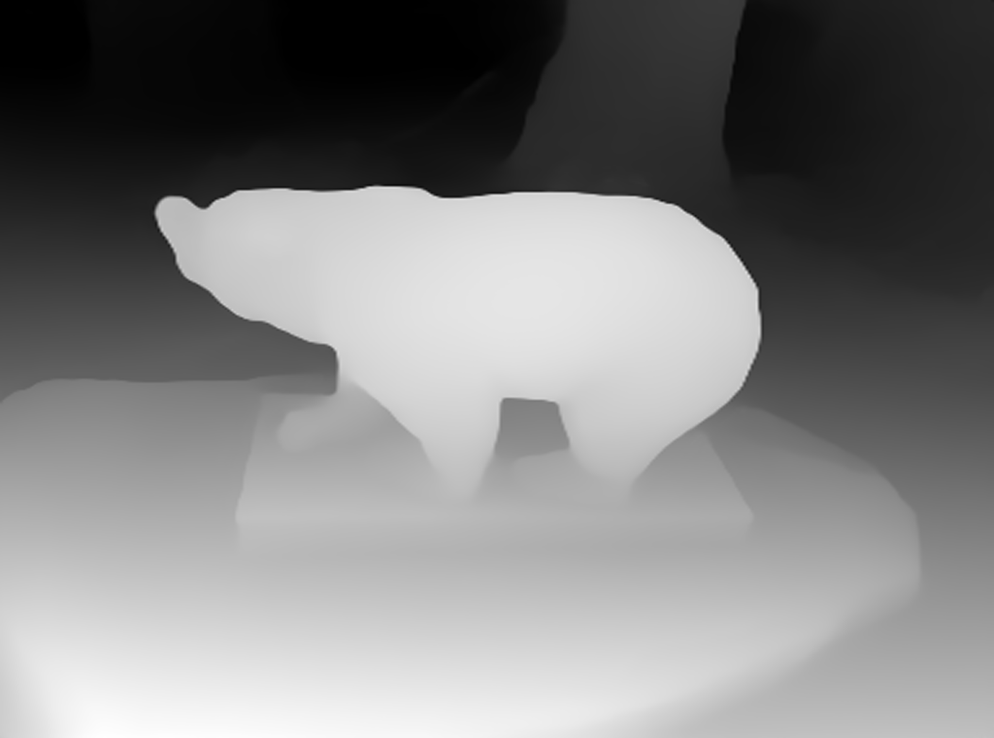
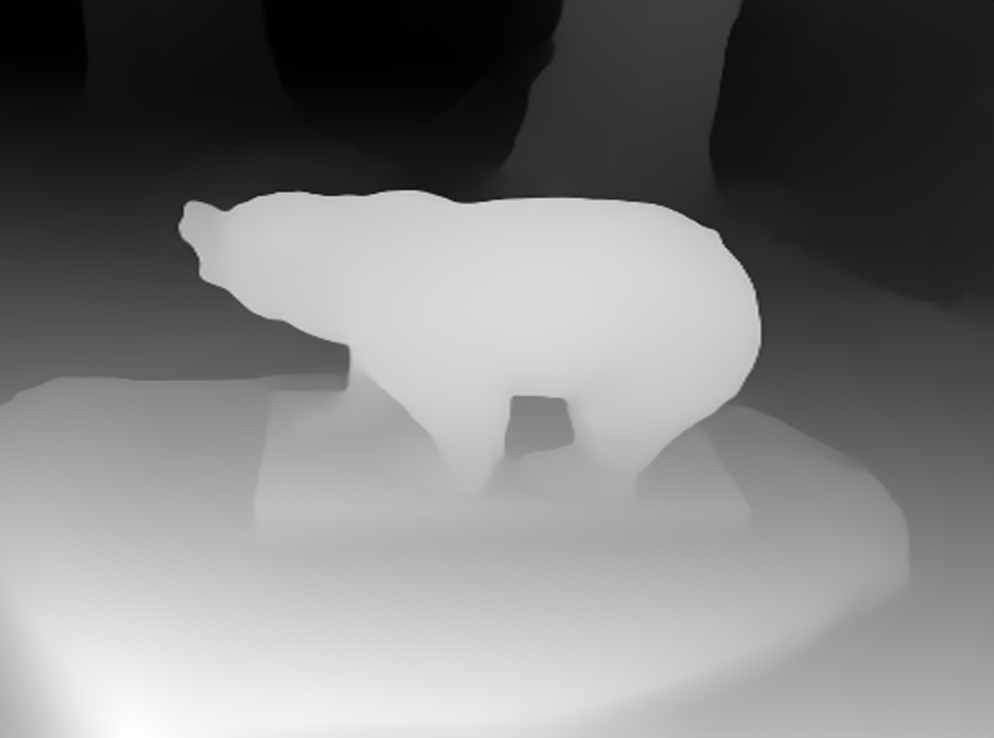
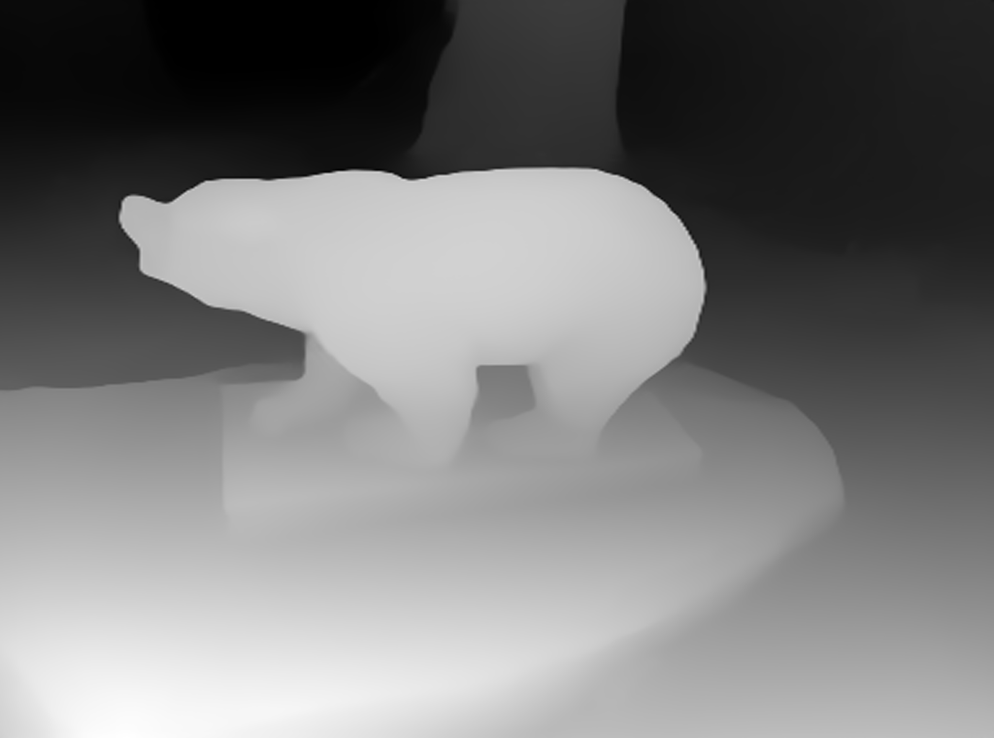
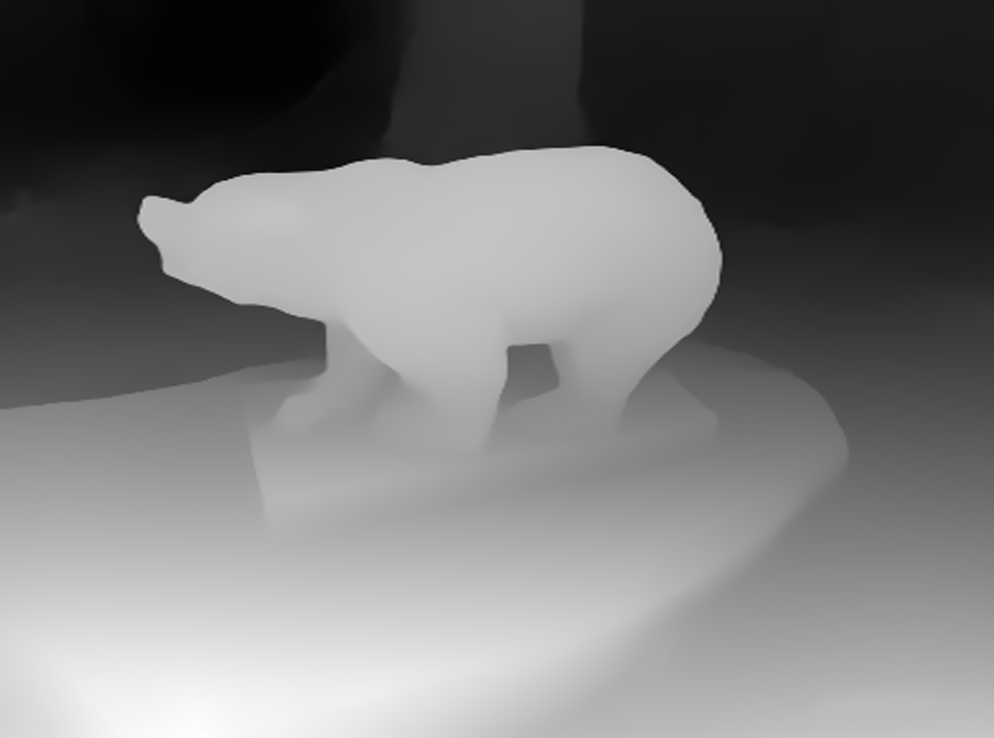

In [7]:
# Depth estimation

H_up = images[0].size[1]
W_up = images[0].size[0]
print('Size:', H_up, W_up)

depth_images = [sp2p.get_depth_map(images[i], sp2p.feature_processor, sp2p.depth_estimator) for i in range(0, len(img_indices))]
if upscale_image:
    depth_images = [img.resize((2*W, 2*H)) for img in depth_images]
else:
    depth_images = [img.resize((W, H)) for img in depth_images]

mediapy.show_images(images[:4])
mediapy.show_images(depth_images[:4])

In [8]:
# generate stylized images

def generate_views(prompt, guidance_scale=7.5, strength=0.9, num_steps=50, seed=42, length=18, show_images=False):
    N = len(images)
    stride = length
    controlnet_conditioning_scale = 1. #0.8#1. #1. #0.8
    num_images_per_prompt = 1
    print(f'num_of_views={N}, length={length}, stride={stride}, controlnet conditioning scale={controlnet_conditioning_scale}, seed={seed}')
    print('prompt:', prompt)
    
    print('Guidance Scale:', guidance_scale)

    images_out = []
    
    sp2p.pipe.scheduler = DDIMScheduler.from_pretrained(DDIM_SOURCE, subfolder="scheduler")
    #generator = torch.Generator(device="cuda").manual_seed(seed)
    
    #for i in range(0, 1):
    for i in range(0, (N-length)//stride+2):
        #print(l[stride*i:stride*i+length])
        generator = torch.Generator(device="cuda").manual_seed(seed)
    
        ii = min(stride*i+length, N)
        if ii == N:
            k = N-i*stride
        else:
            k = stride
        print(ii-stride*i)
        
        images_style = sp2p.controlnet_img2img_call(sp2p.pipe,
                                                [prompt]*(ii-stride*i),
                                                image=images[stride*i:ii],
                                                control_image=depth_images[stride*i:ii],
                                                strength=strength, #0.9-1.0 usually works
                                                guidance_scale=guidance_scale,
                                                num_inference_steps=num_steps, # 50
                                                controlnet_conditioning_scale=controlnet_conditioning_scale,
                                                num_images_per_prompt=num_images_per_prompt,
                                                generator=generator,
                                                #latents=latents
                                                )
        #images_pt = sp2p.pipe.image_processor.postprocess(images_style, output_type='pt')  
        images_PIL = sp2p.pipe.image_processor.postprocess(images_style, output_type='pil')
        if show_images:
            mediapy.show_images(images_PIL)
        images_out += images_PIL
    return images_out


In [9]:
# save generated views

## only fangzhou data needs png not jpg...
import os
import shutil

def save_generated_views(target_path, orig_scene_path):
    #images = [load_image(f"../instruct-nerf2nerf/data/campsite-small/images/frame_{str(i).zfill(5)}.jpg") for i in img_indices]
    H = images[0].size[1]
    W = images[0].size[0]
    
    if not os.path.exists(target_path):
        os.mkdir(target_path)
        os.mkdir(target_path + '/images')
        os.mkdir(target_path + '/camera_paths')
    
    for i, idx in enumerate(img_indices):
        if upscale_image:
            images_stylized[i].resize((int(W/2), int(H/2))).save(f"{target_path}/images/frame_{str(idx).zfill(5)}.jpg")
        else:
            images_stylized[i].resize((W, H)).save(f"{target_path}/images/frame_{str(idx).zfill(5)}.jpg")
        
    # Copy transforms.json and make symlinks for masks and gt images
    shutil.copy(f'{orig_scene_path}/transforms.json', f'{target_path}')
    #os.symlink(f'../../{orig_scene_path}/images', f'{target_path}/images_second')
    #os.symlink(f'../../{orig_scene_path}/masks', f'{target_path}/masks')
    
    scene_name = target_path.split('/')[-1]
    
    print(f'Saving gif as {scene_name}.gif')
    imageio.mimsave(f'{target_path}/{scene_name}.gif', images_stylized)

scene_name: bear-vangogh for prompt: "a bear, Vincent Van Gogh painting style"
num_of_views=96, length=18, stride=18, controlnet conditioning scale=1.0, seed=42
prompt: a bear, Vincent Van Gogh painting style
Guidance Scale: 15.0
18


  0%|          | 0/47 [00:00<?, ?it/s]

,,,,,,,,,,,,,,,,,

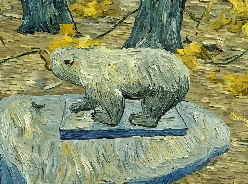
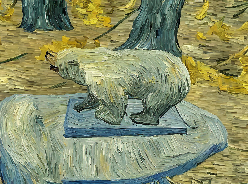
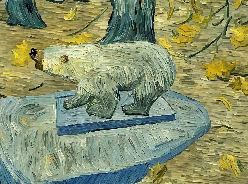
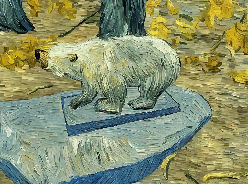
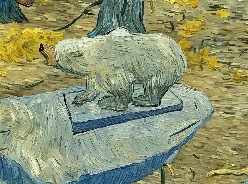
...
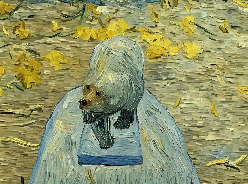
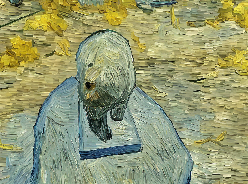
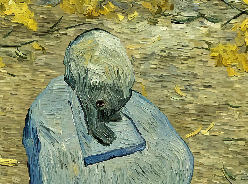
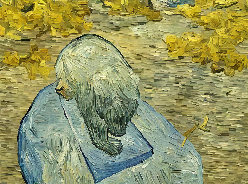
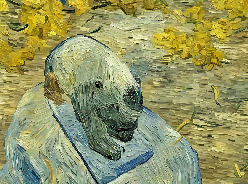

18


  0%|          | 0/47 [00:00<?, ?it/s]

In [ ]:
# dataset generation loop

prompt = 'a bear, Vincent Van Gogh painting style'
guidance_scale = 15.
strength = 0.95
scene_name = 'bear-vangogh'
seed = 42 #, 10, 20]
length = 18 # Adjust according to gpu memory

target_path = f'data/{scene_name}'
print(f'scene_name: {scene_name} for prompt: "{prompt}"')

# Generate
images_stylized = []
images_stylized = generate_views(prompt, guidance_scale=guidance_scale, strength=strength, num_steps=50, seed=seed, show_images=True)

print(len(images_stylized))
mediapy.show_images(images[:6])
mediapy.show_images(images_stylized[:6])
save_generated_views(target_path, source_path)

# Generate round end
print(f'Stylized views saved under {target_path}')

train_command = f'ns-train sn2n --data {target_path} --load-dir [path-to-trained-source-nerf] --vis viewer --save-only-latest-checkpoint True'
print(train_command)
# something like: ns-train sn2n --data data/bear-vangogh --load-dir outputs/bear/nerfacto/2024-12-05_112654/nerfstudio_models --pipeline.model.use-l1 True --pipeline.model.swd-loss-mult 1.0 --pipeline.model.orientation-loss-mult 0 --pipeline.model.pred-normal-loss-mult 0 

In [41]:
# Release CUDA memory after multi-view generation

from notebook.notebookapp import list_running_servers
from IPython import get_ipython

# Find the current kernel ID
kernel_id = get_ipython().kernel.session.session

# Stop the kernel via a system command
os.system(f"jupyter notebook stop {kernel_id}")

<IPython.core.display.Javascript object>

## END

,,,

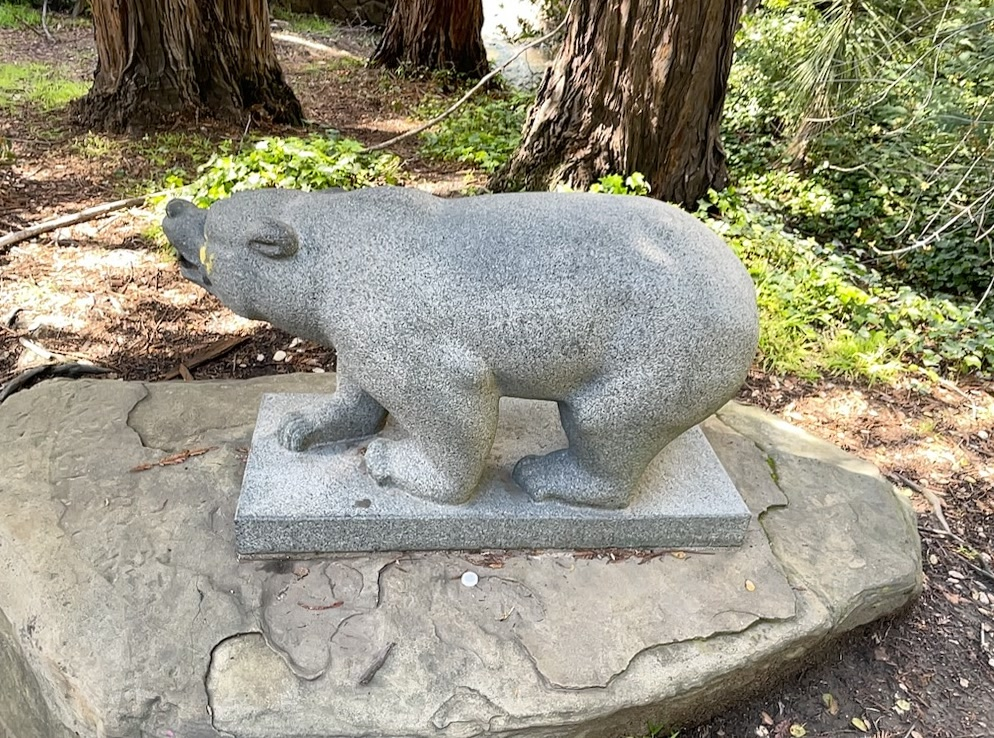
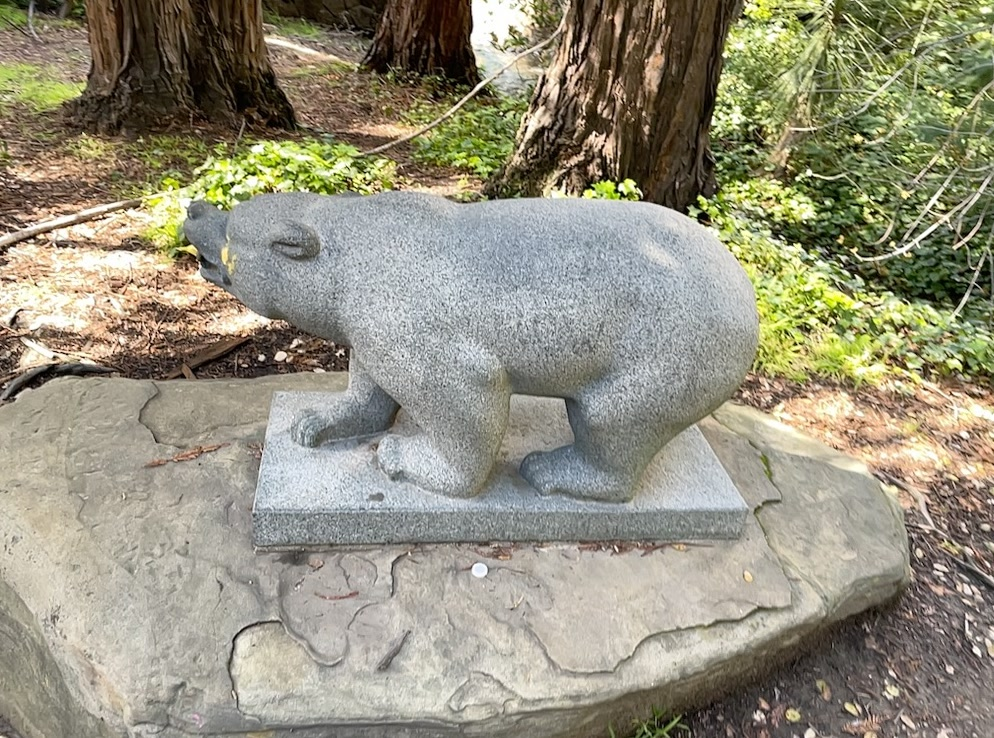
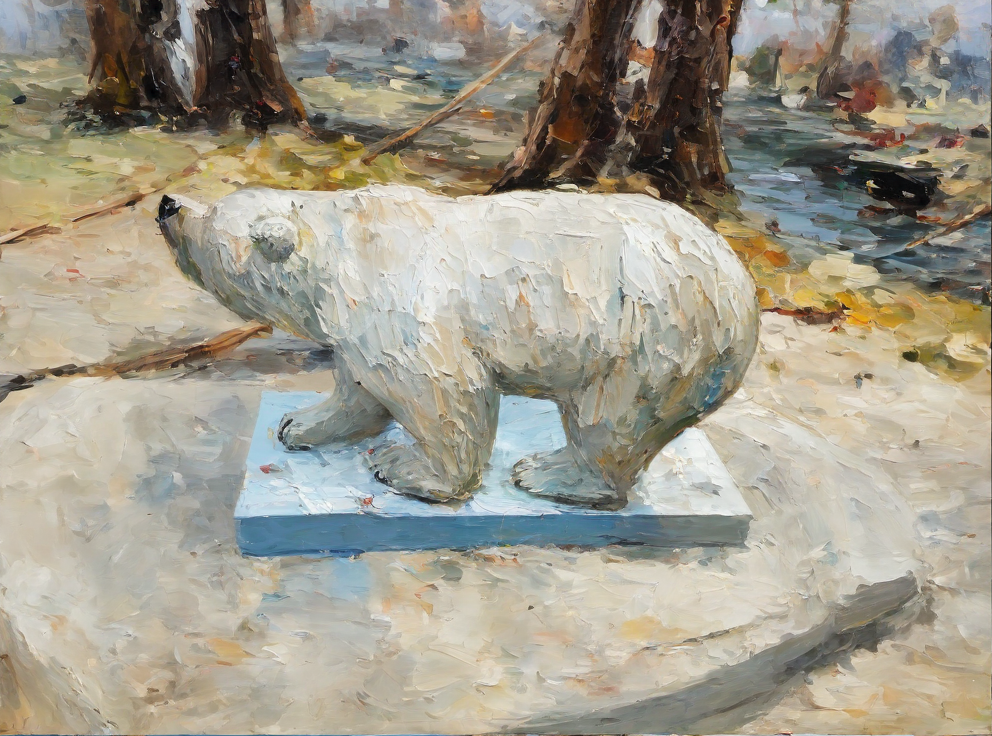
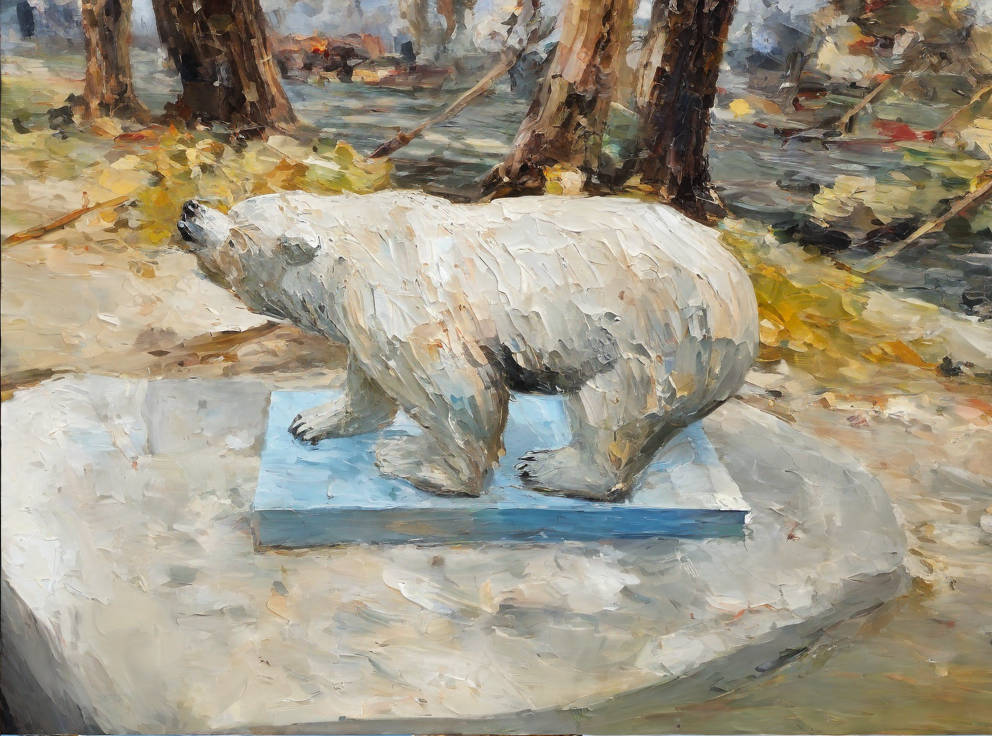

In [34]:
mediapy.show_images(images[:2]+ images_stylized[:2])

,,,

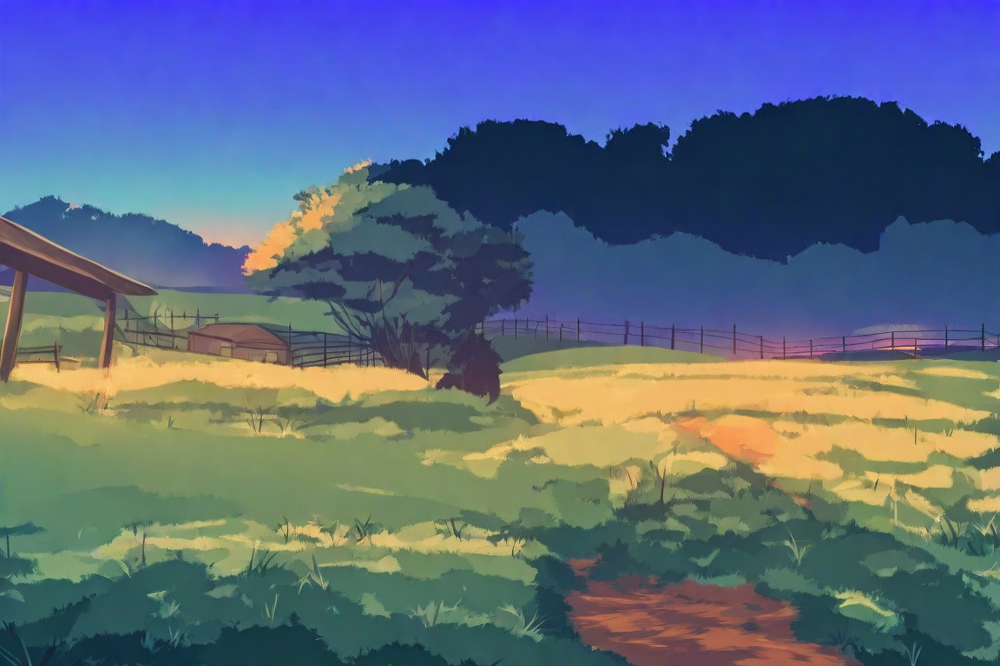
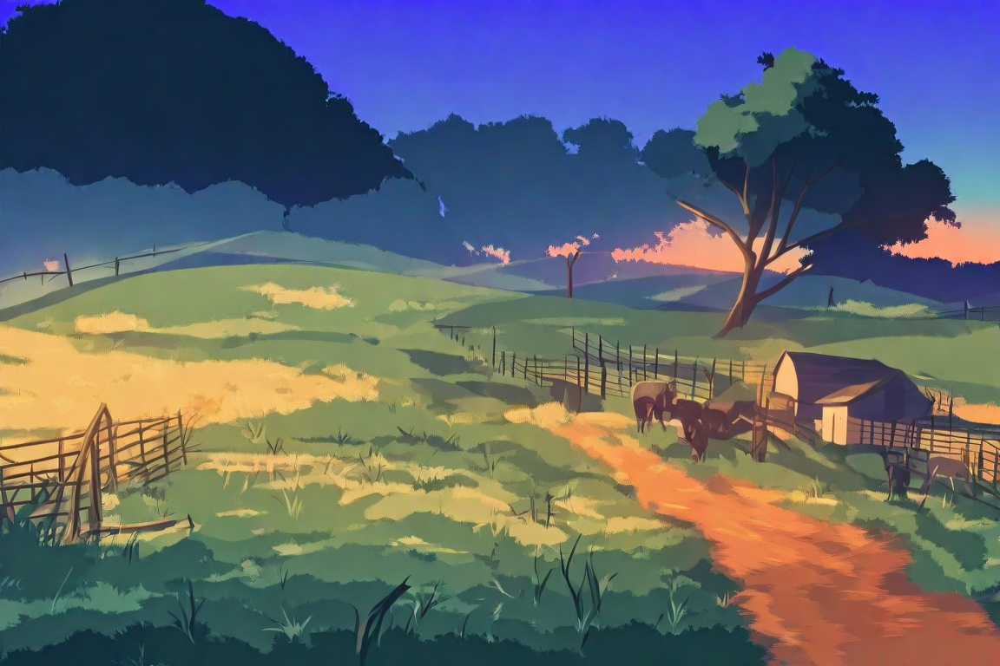
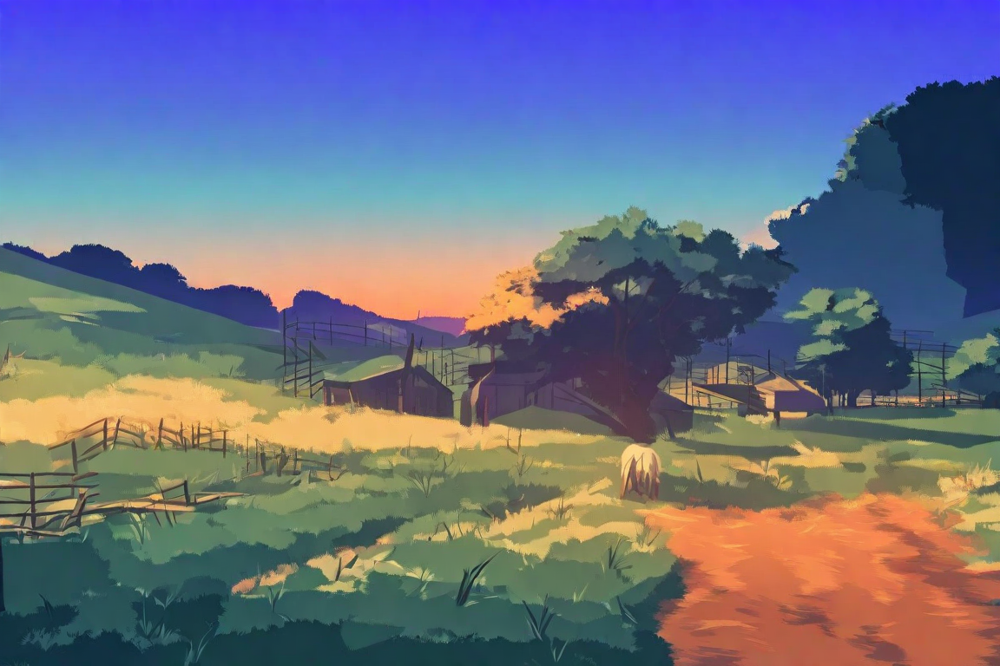
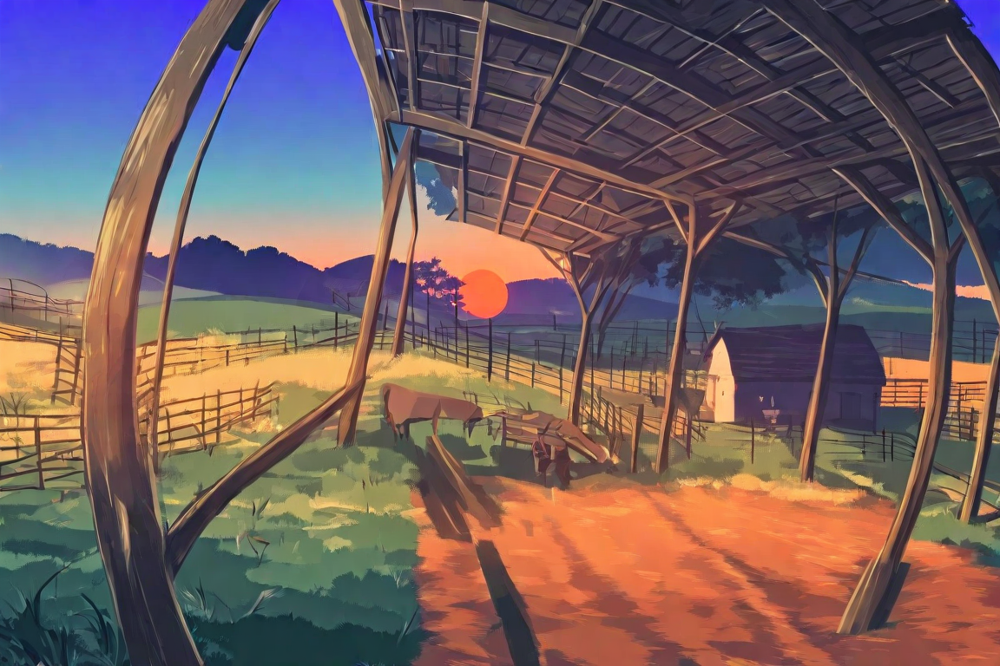

In [32]:
mediapy.show_images(images_PIL)

,,,,,,,

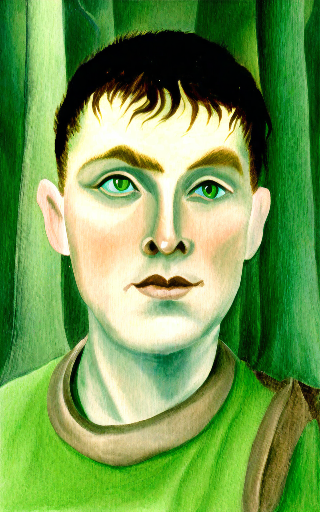
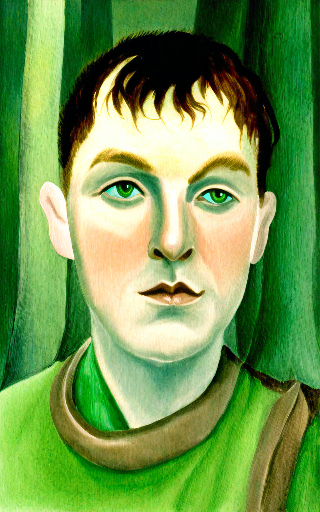
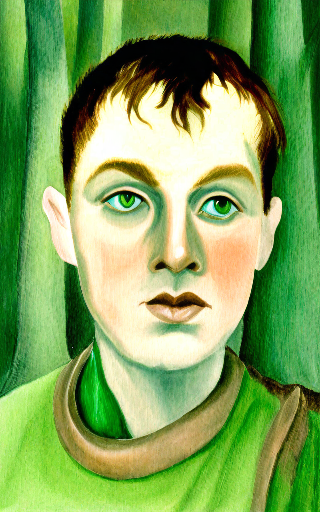
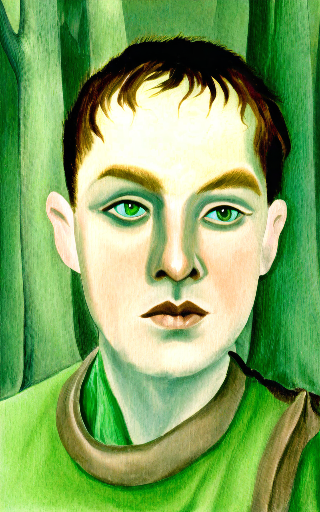
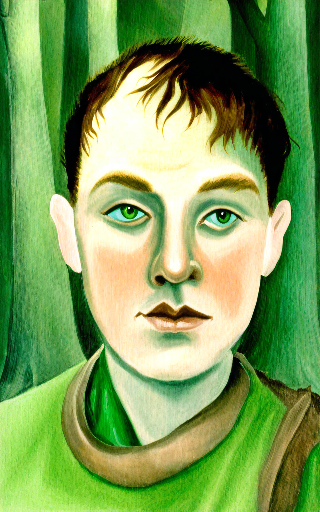
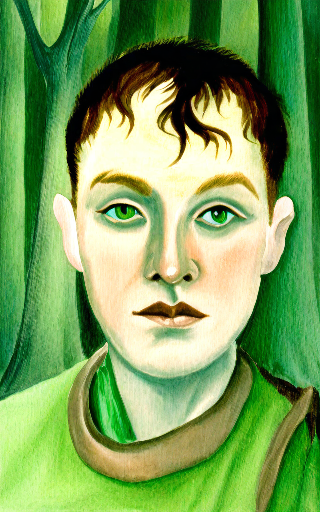
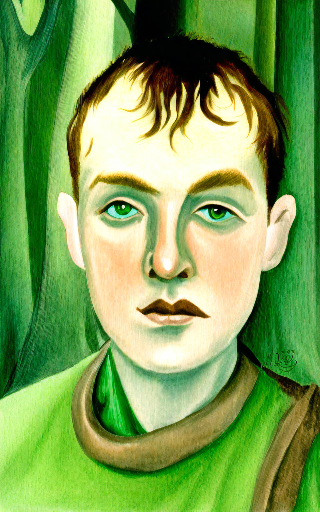
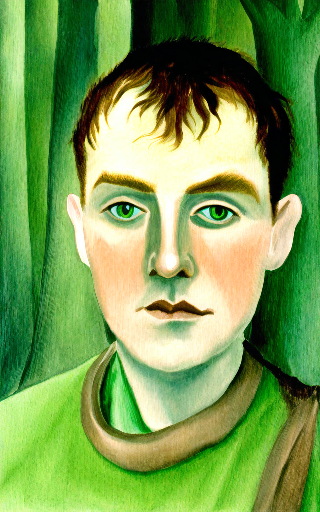

In [42]:
mediapy.show_images(images_PIL) # 

,,,,,,,

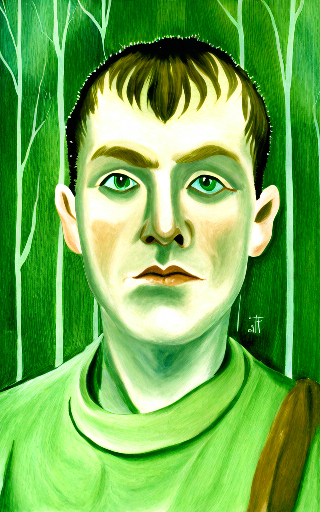
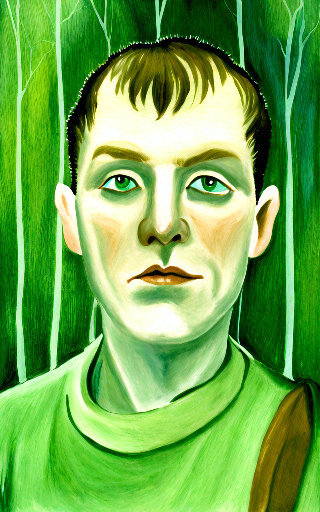
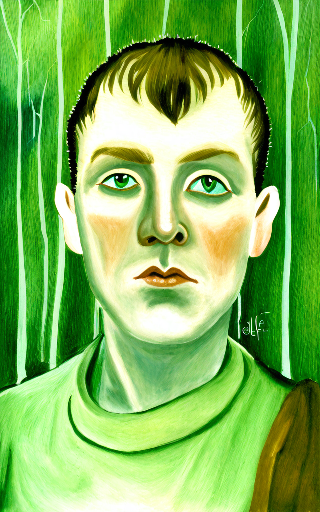
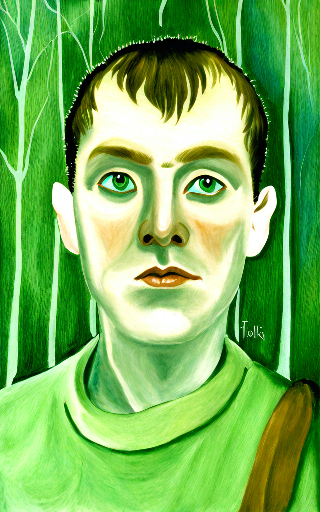
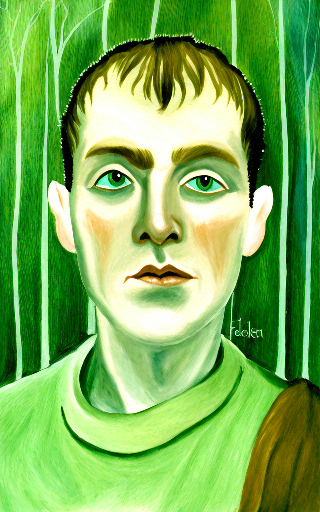
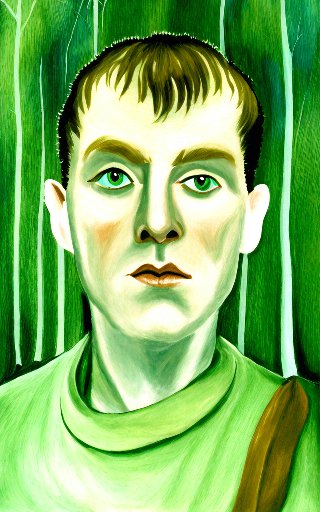
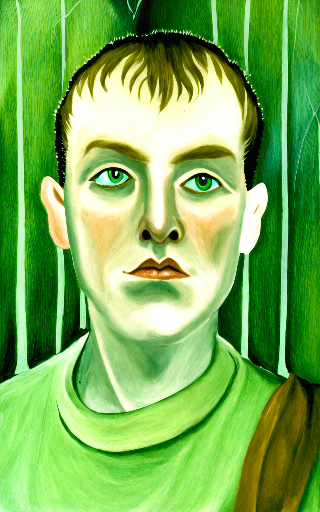
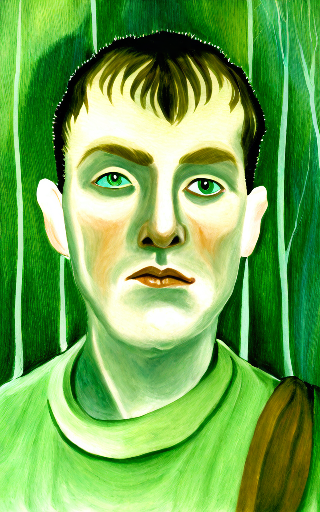

In [40]:
mediapy.show_images(images_PIL) # 

,,,

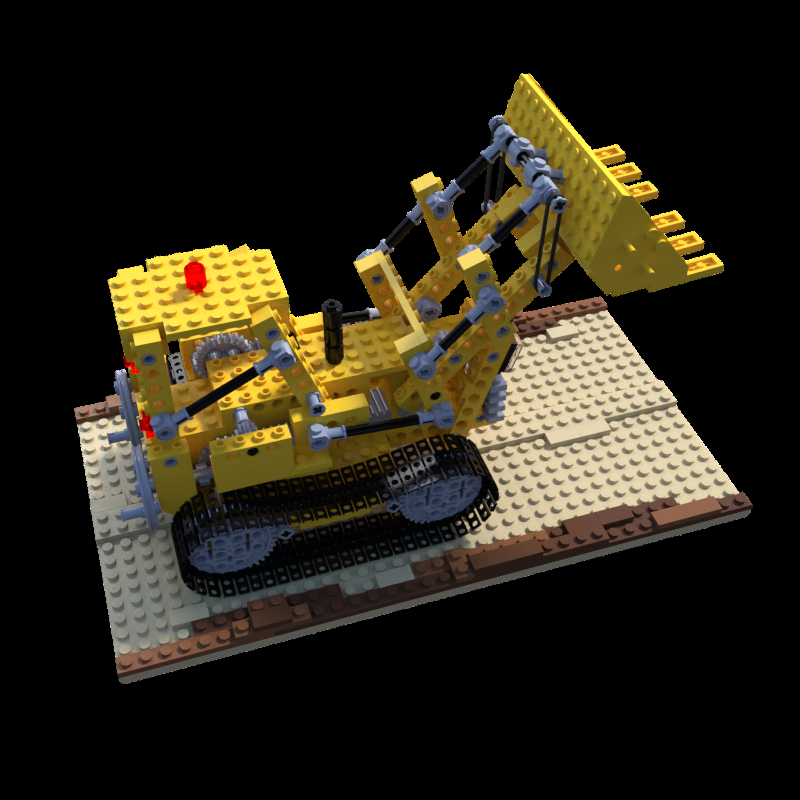
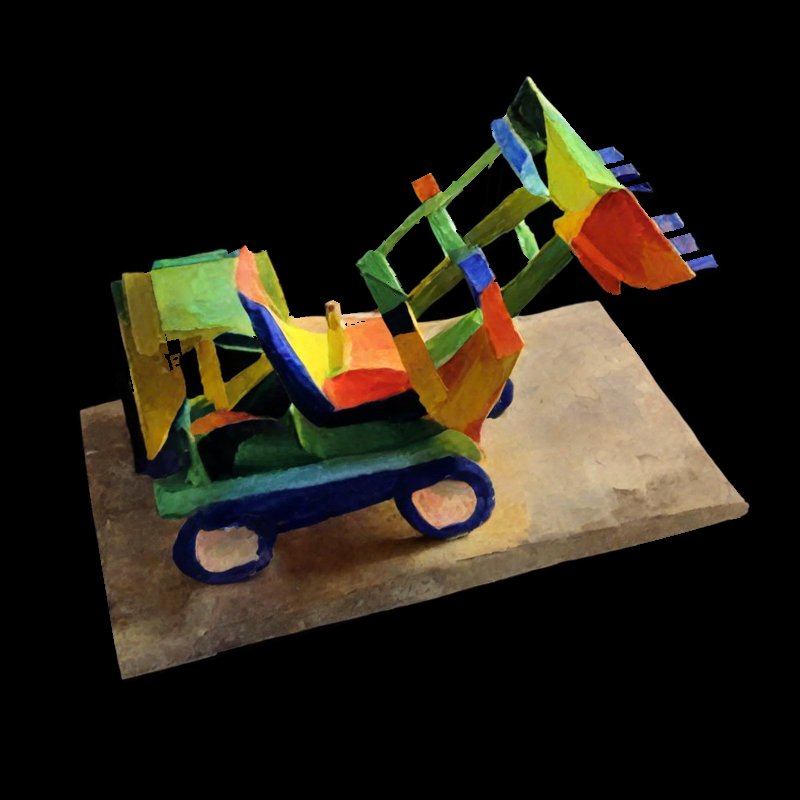
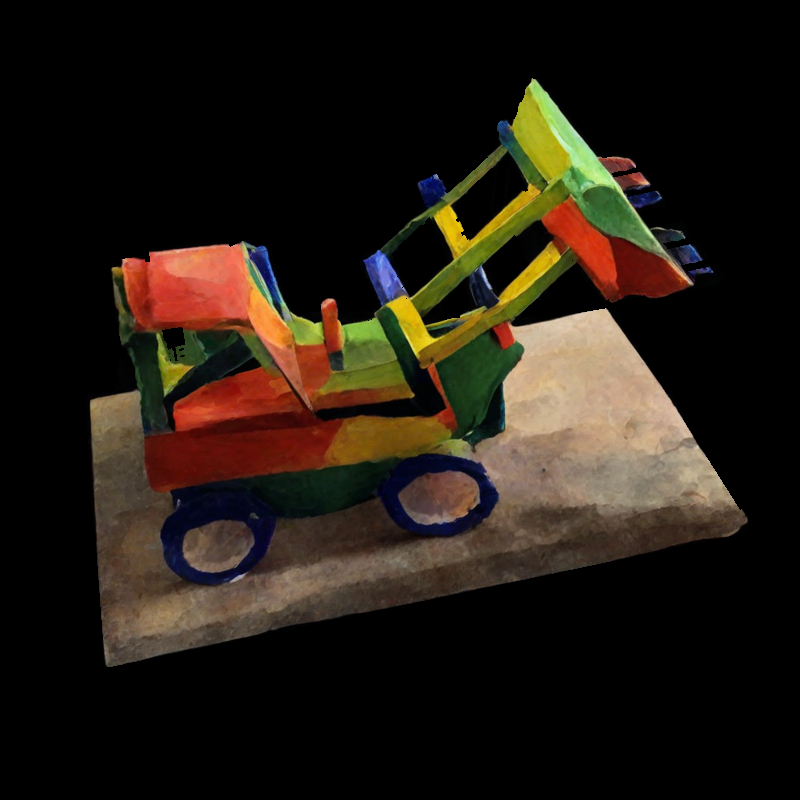
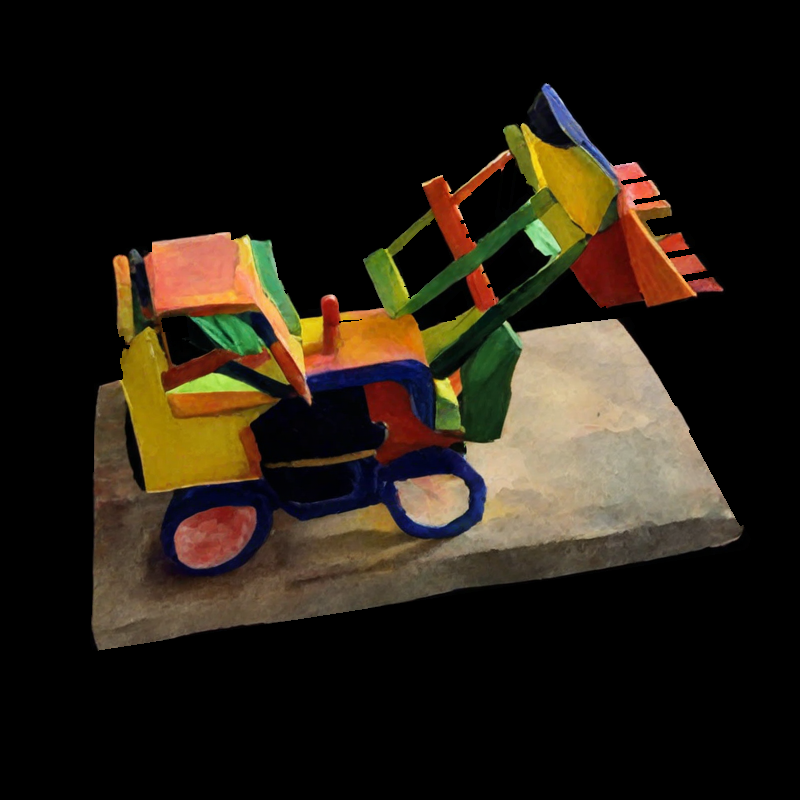

In [52]:
mediapy.show_images([images[0]] + images_PIL)